In [ ]:
# Step 1: Import required libraries
import pandas as pd
import numpy as np

# Step 2: Load the dataset
file_path = "/content/amazon_delivery.csv"  # Update path if needed
df = pd.read_csv(file_path)

# Step 3: Basic inspection
print("Shape of dataset:", df.shape)  # Rows & columns
print("\nColumn names:", df.columns.tolist())
print("\nFirst 5 rows:")
display(df.head())

# Step 4: Check info and missing values
print("\nDataset Info:")
print(df.info())

print("\nMissing values per column:")
print(df.isnull().sum())


Shape of dataset: (23030, 16)

Column names: ['Order_ID', 'Agent_Age', 'Agent_Rating', 'Store_Latitude', 'Store_Longitude', 'Drop_Latitude', 'Drop_Longitude', 'Order_Date', 'Order_Time', 'Pickup_Time', 'Weather', 'Traffic', 'Vehicle', 'Area', 'Delivery_Time', 'Category']

First 5 rows:


,Order_ID,Agent_Age,Agent_Rating,Store_Latitude,Store_Longitude,Drop_Latitude,Drop_Longitude,Order_Date,Order_Time,Pickup_Time,Weather,Traffic,Vehicle,Area,Delivery_Time,Category
0,ialx566343618,37.0,4.9,22.745049,75.892471,22.765049,75.912471,2022-03-19,11:30:00,11:45:00,Sunny,High,motorcycle,Urban,120.0,Clothing
1,akqg208421122,34.0,4.5,12.913041,77.683237,13.043041,77.813237,2022-03-25,19:45:00,19:50:00,Stormy,Jam,scooter,Metropolitian,165.0,Electronics
2,njpu434582536,23.0,4.4,12.914264,77.678400,12.924264,77.688400,2022-03-19,08:30:00,08:45:00,Sandstorms,Low,motorcycle,Urban,130.0,Sports
3,rjto796129700,38.0,4.7,11.003669,76.976494,11.053669,77.026494,2022-04-05,18:00:00,18:10:00,Sunny,Medium,motorcycle,Metropolitian,105.0,Cosmetics
4,zguw716275638,32.0,4.6,12.972793,80.249982,13.012793,80.289982,2022-03-26,13:30:00,13:45:00,Cloudy,High,scooter,Metropolitian,150.0,Toys



Dataset Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23030 entries, 0 to 23029
Data columns (total 16 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Order_ID         23030 non-null  object 
 1   Agent_Age        23029 non-null  float64
 2   Agent_Rating     22996 non-null  float64
 3   Store_Latitude   23029 non-null  float64
 4   Store_Longitude  23029 non-null  float64
 5   Drop_Latitude    23029 non-null  float64
 6   Drop_Longitude   23029 non-null  float64
 7   Order_Date       23029 non-null  object 
 8   Order_Time       23029 non-null  object 
 9   Pickup_Time      23029 non-null  object 
 10  Weather          22984 non-null  object 
 11  Traffic          23029 non-null  object 
 12  Vehicle          23029 non-null  object 
 13  Area             23029 non-null  object 
 14  Delivery_Time    23029 non-null  float64
 15  Category         23029 non-null  object 
dtypes: float64(7), object(9)
memory usage: 2.8+

In [ ]:
# Remove duplicate rows if any
print("Duplicate rows before:", df.duplicated().sum())
df = df.drop_duplicates()
print("Duplicate rows after:", df.duplicated().sum())

# Handle missing values
print("\nMissing values before handling:")
print(df.isnull().sum())

# Example: Fill missing numerical values with median
num_cols = df.select_dtypes(include=[np.number]).columns
for col in num_cols:
    df[col] = df[col].fillna(df[col].median())

# Example: Fill missing categorical values with mode
cat_cols = df.select_dtypes(include=['object']).columns
for col in cat_cols:
    df[col] = df[col].fillna(df[col].mode()[0])

print("\nMissing values after handling:")
print(df.isnull().sum())

# Standardize categorical variables
# Convert text to lowercase and strip spaces
for col in cat_cols:
    df[col] = df[col].str.lower().str.strip()

# Check cleaned dataset
print("\nShape after cleaning:", df.shape)
display(df.head())


Duplicate rows before: 0
Duplicate rows after: 0

Missing values before handling:
Order_ID            0
Agent_Age           1
Agent_Rating       34
Store_Latitude      1
Store_Longitude     1
Drop_Latitude       1
Drop_Longitude      1
Order_Date          1
Order_Time          1
Pickup_Time         1
Weather            46
Traffic             1
Vehicle             1
Area                1
Delivery_Time       1
Category            1
dtype: int64

Missing values after handling:
Order_ID           0
Agent_Age          0
Agent_Rating       0
Store_Latitude     0
Store_Longitude    0
Drop_Latitude      0
Drop_Longitude     0
Order_Date         0
Order_Time         0
Pickup_Time        0
Weather            0
Traffic            0
Vehicle            0
Area               0
Delivery_Time      0
Category           0
dtype: int64

Shape after cleaning: (23030, 16)


,Order_ID,Agent_Age,Agent_Rating,Store_Latitude,Store_Longitude,Drop_Latitude,Drop_Longitude,Order_Date,Order_Time,Pickup_Time,Weather,Traffic,Vehicle,Area,Delivery_Time,Category
0,ialx566343618,37.0,4.9,22.745049,75.892471,22.765049,75.912471,2022-03-19,11:30:00,11:45:00,sunny,high,motorcycle,urban,120.0,clothing
1,akqg208421122,34.0,4.5,12.913041,77.683237,13.043041,77.813237,2022-03-25,19:45:00,19:50:00,stormy,jam,scooter,metropolitian,165.0,electronics
2,njpu434582536,23.0,4.4,12.914264,77.678400,12.924264,77.688400,2022-03-19,08:30:00,08:45:00,sandstorms,low,motorcycle,urban,130.0,sports
3,rjto796129700,38.0,4.7,11.003669,76.976494,11.053669,77.026494,2022-04-05,18:00:00,18:10:00,sunny,medium,motorcycle,metropolitian,105.0,cosmetics
4,zguw716275638,32.0,4.6,12.972793,80.249982,13.012793,80.289982,2022-03-26,13:30:00,13:45:00,cloudy,high,scooter,metropolitian,150.0,toys



Basic Statistics of Numerical Features:


,Agent_Age,Agent_Rating,Store_Latitude,Store_Longitude,Drop_Latitude,Drop_Longitude,Delivery_Time
count,23030.000000,23030.000000,23030.000000,23030.000000,23030.000000,23030.000000,23030.000000
mean,29.585845,4.633634,17.191861,70.781370,17.437183,70.927567,125.024099
std,5.805030,0.332200,7.735149,21.305836,7.319064,21.029496,52.114733
min,15.000000,1.000000,-30.902872,-85.335486,0.010000,0.010000,10.000000
25%,25.000000,4.500000,12.933284,73.170937,12.984179,73.297753,90.000000
50%,30.000000,4.700000,18.551440,75.902847,18.630016,76.019490,125.000000
75%,35.000000,4.900000,22.728163,78.046106,22.782634,78.110453,160.000000
max,50.000000,6.000000,30.914057,88.433452,31.045562,88.563452,270.000000


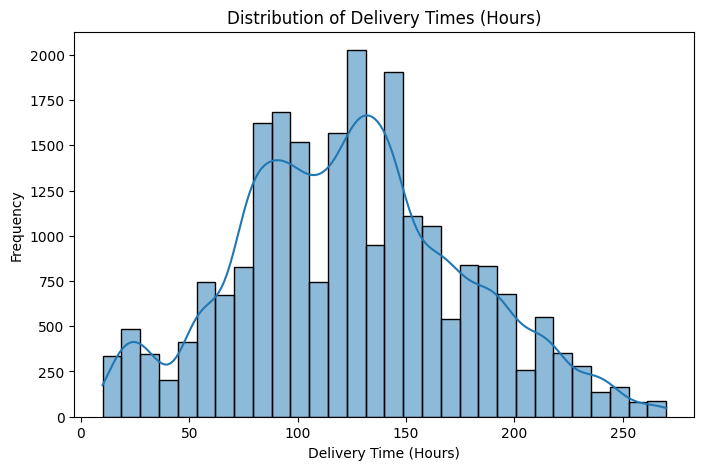

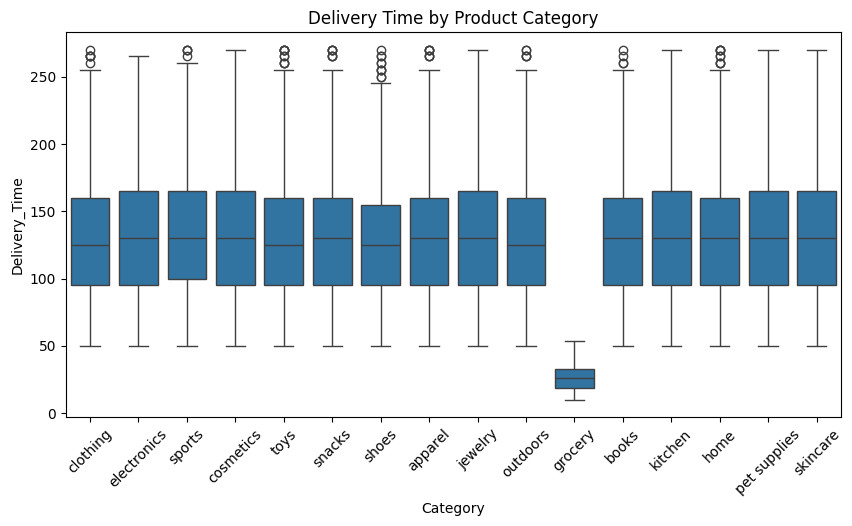

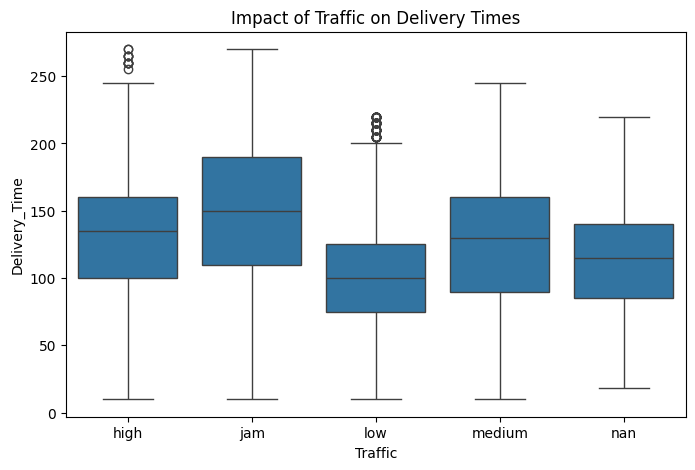

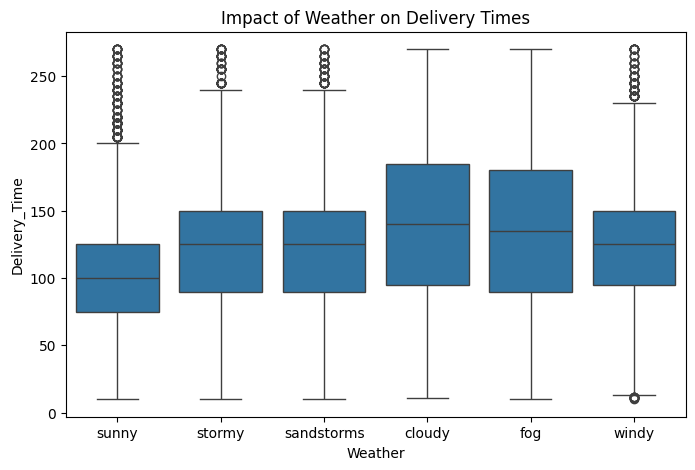

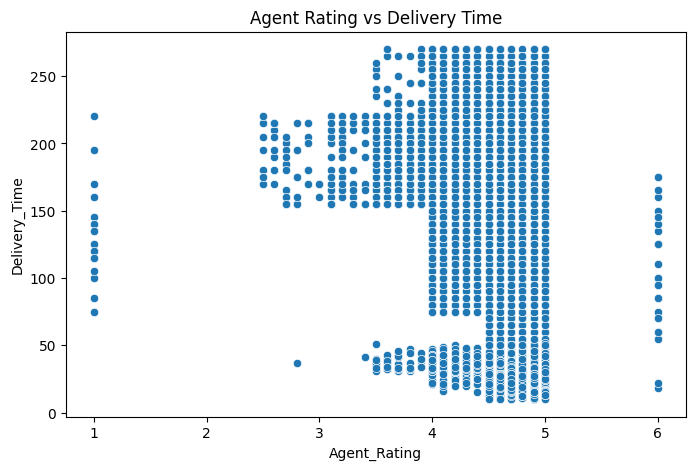

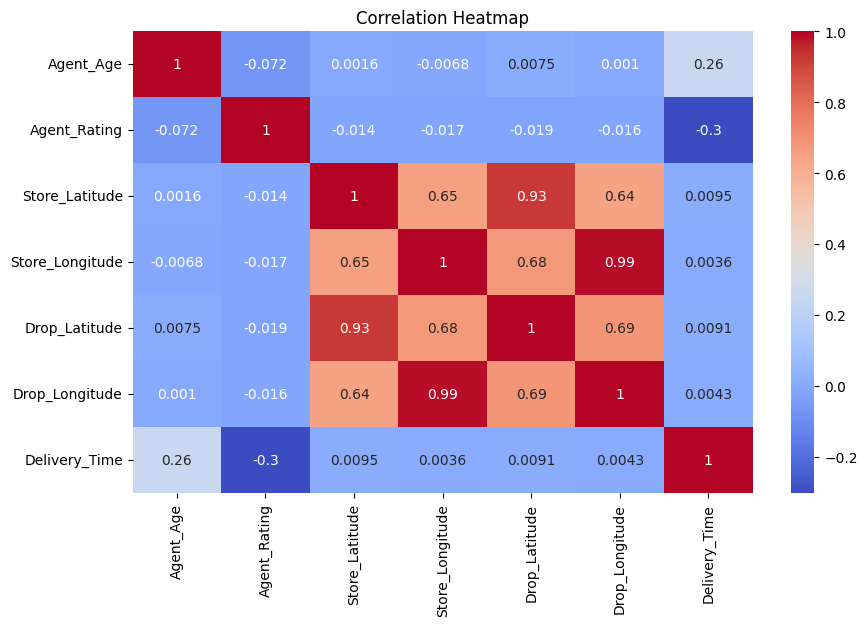

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Basic statistics
print("\nBasic Statistics of Numerical Features:")
display(df.describe())

# 1. Distribution of delivery times
plt.figure(figsize=(8,5))
sns.histplot(df['Delivery_Time'], bins=30, kde=True)
plt.title("Distribution of Delivery Times (Hours)")
plt.xlabel("Delivery Time (Hours)")
plt.ylabel("Frequency")
plt.show()

# 2. Delivery Time by Product Category
plt.figure(figsize=(10,5))
sns.boxplot(x='Category', y='Delivery_Time', data=df)
plt.title("Delivery Time by Product Category")
plt.xticks(rotation=45)
plt.show()

# 3. Impact of Traffic on Delivery Time
plt.figure(figsize=(8,5))
sns.boxplot(x='Traffic', y='Delivery_Time', data=df)
plt.title("Impact of Traffic on Delivery Times")
plt.show()

# 4. Impact of Weather on Delivery Time
plt.figure(figsize=(8,5))
sns.boxplot(x='Weather', y='Delivery_Time', data=df)
plt.title("Impact of Weather on Delivery Times")
plt.show()

# 5. Relationship: Distance vs Delivery Time
# (We will calculate distance later in Feature Engineering, for now just check store vs drop lat/long)
plt.figure(figsize=(8,5))
sns.scatterplot(x='Agent_Rating', y='Delivery_Time', data=df)
plt.title("Agent Rating vs Delivery Time")
plt.show()

# 6. Correlation Heatmap
plt.figure(figsize=(10,6))
corr = df.corr(numeric_only=True)
sns.heatmap(corr, annot=True, cmap='coolwarm')
plt.title("Correlation Heatmap")
plt.show()


In [ ]:
from math import radians, sin, cos, sqrt, atan2
import pandas as pd

# Function to calculate distance using Haversine formula
def haversine(lat1, lon1, lat2, lon2):
    R = 6371  # Earth radius in kilometers
    lat1, lon1, lat2, lon2 = map(radians, [lat1, lon1, lat2, lon2])
    dlon = lon2 - lon1
    dlat = lat2 - lat1
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * atan2(sqrt(a), sqrt(1-a))
    distance = R * c
    return distance

# Apply distance calculation
df['Distance_km'] = df.apply(lambda row: haversine(
    row['Store_Latitude'], row['Store_Longitude'],
    row['Drop_Latitude'], row['Drop_Longitude']), axis=1)

# Convert date & time columns to datetime format
df['Order_Date'] = pd.to_datetime(df['Order_Date'], errors='coerce')
df['Order_Time'] = pd.to_datetime(df['Order_Time'], format='%H:%M:%S', errors='coerce')
df['Pickup_Time'] = pd.to_datetime(df['Pickup_Time'], format='%H:%M:%S', errors='coerce')

# Extract time-based features
df['Order_Hour'] = df['Order_Time'].dt.hour
df['Day_of_Week'] = df['Order_Date'].dt.dayofweek  # 0 = Monday, 6 = Sunday

# Handle categorical variables with One-Hot Encoding
cat_features = ['Weather', 'Traffic', 'Vehicle', 'Area', 'Category']
df = pd.get_dummies(df, columns=cat_features, drop_first=True)

print("Dataset after Feature Engineering:", df.shape)
display(df.head())


Dataset after Feature Engineering: (23030, 44)


,Order_ID,Agent_Age,Agent_Rating,Store_Latitude,Store_Longitude,Drop_Latitude,Drop_Longitude,Order_Date,Order_Time,Pickup_Time,...,Category_home,Category_jewelry,Category_kitchen,Category_outdoors,Category_pet supplies,Category_shoes,Category_skincare,Category_snacks,Category_sports,Category_toys
0,ialx566343618,37.0,4.9,22.745049,75.892471,22.765049,75.912471,2022-03-19,1900-01-01 11:30:00,1900-01-01 11:45:00,...,False,False,False,False,False,False,False,False,False,False
1,akqg208421122,34.0,4.5,12.913041,77.683237,13.043041,77.813237,2022-03-25,1900-01-01 19:45:00,1900-01-01 19:50:00,...,False,False,False,False,False,False,False,False,False,False
2,njpu434582536,23.0,4.4,12.914264,77.678400,12.924264,77.688400,2022-03-19,1900-01-01 08:30:00,1900-01-01 08:45:00,...,False,False,False,False,False,False,False,False,True,False
3,rjto796129700,38.0,4.7,11.003669,76.976494,11.053669,77.026494,2022-04-05,1900-01-01 18:00:00,1900-01-01 18:10:00,...,False,False,False,False,False,False,False,False,False,False
4,zguw716275638,32.0,4.6,12.972793,80.249982,13.012793,80.289982,2022-03-26,1900-01-01 13:30:00,1900-01-01 13:45:00,...,False,False,False,False,False,False,False,False,False,True


In [ ]:
# Code for imputation and model training has been moved to cell kruO8sktAVZg

In [ ]:
from sklearn.impute import SimpleImputer
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import numpy as np
import pandas as pd
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor


# Define features (X) and target (y)
X = df.drop(['Order_ID', 'Order_Date', 'Order_Time', 'Pickup_Time', 'Delivery_Time'], axis=1)
y = df['Delivery_Time']

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# 🔧 Step 1: Double-check missing values (after splitting)
print("Missing values before fix:")
print(X_train.isnull().sum()[X_train.isnull().sum() > 0])


# 🔧 Step 2: Impute missing values
# Use median for numeric values
imputer = SimpleImputer(strategy='median')

# Identify numeric and categorical columns
numeric_cols = X_train.select_dtypes(include=np.number).columns
categorical_cols = X_train.select_dtypes(include='object').columns

# Impute numeric columns
X_train[numeric_cols] = imputer.fit_transform(X_train[numeric_cols])
X_test[numeric_cols] = imputer.transform(X_test[numeric_cols])

# Impute categorical columns (if any - based on the data, it seems they are already one-hot encoded)
# If there were any object columns left, you would need a different imputer strategy,
# but since we've one-hot encoded, we can skip this step for object types.
# If you had non-encoded object columns with NaNs, you might use:
# cat_imputer = SimpleImputer(strategy='most_frequent')
# X_train[categorical_cols] = cat_imputer.fit_transform(X_train[categorical_cols])
# X_test[categorical_cols] = cat_imputer.transform(X_test[categorical_cols])


print("\nMissing values after fix:")
print(X_train.isnull().sum().sum(), "missing values left")

# 🔧 Step 3: Retrain models
# Assuming 'models' dictionary is defined in a previous cell
# If not, you would need to define it here, e.g.:
models = {
    "Linear Regression": LinearRegression(),
    "Random Forest": RandomForestRegressor(random_state=42),
    "Gradient Boosting": GradientBoostingRegressor(random_state=42)
}


results = {}
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    mae = mean_absolute_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)

    results[name] = {"RMSE": rmse, "MAE": mae, "R2": r2}

# 🔧 Step 4: Show comparison
results_df = pd.DataFrame(results).T
print("\nModel Comparison Results After Fix:")
display(results_df)

Missing values before fix:
Order_Hour    37
dtype: int64

Missing values after fix:
0 missing values left

Model Comparison Results After Fix:


,RMSE,MAE,R2
Linear Regression,33.002540,25.921880,0.607511
Random Forest,23.200603,17.815065,0.806032
Gradient Boosting,25.062975,19.440865,0.773641


In [ ]:
!pip install streamlit
!pip install pyngrok  # if you want to run streamlit app inside Colab


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.1/10.1 MB 88.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.9/6.9 MB 116.2 MB/s eta 0:00:00


In [ ]:
# Install pyngrok if not installed
!pip install pyngrok --quiet

# Set your real ngrok token here
!ngrok authtoken "33avzRL4i89SBxOsrc77ej5rPDx_33oizDNYWpLQwBXfv4r72"


Authtoken saved to configuration file: /root/.config/ngrok/ngrok.yml


In [ ]:
from pyngrok import ngrok
import os
import time

ngrok.kill()  # kill old tunnels
os.environ["STREAMLIT_SERVER_HEADLESS"] = "true"

# Run Streamlit in background
get_ipython().system_raw("streamlit run app.py --server.port 8501 --server.address 0.0.0.0 &")

time.sleep(5)  # give Streamlit time to start

public_url = ngrok.connect(addr="8501", proto="http")
print("Streamlit app running on:", public_url)


Streamlit app running on: NgrokTunnel: "https://8b9c5b4df482.ngrok-free.app" -> "http://localhost:8501"


In [ ]:
from IPython.display import IFrame

# Embed Streamlit app inside Colab
IFrame(src="https://8b9c5b4df482.ngrok-free.app", width=700, height=600)


In [ ]:
import joblib

# Pick best model based on R2
best_model = results_df['R2'].idxmax()
print("Best model is:", best_model)

# Save it properly with a .pkl filename
joblib.dump(models[best_model], "best_model.pkl")
print("Model saved as best_model.pkl")



Best model is: Random Forest
Model saved as best_model.pkl


In [ ]:
# Load saved model
model = joblib.load("best_model.pkl")


In [ ]:
import os
if os.path.exists("app.py"):
    os.remove("app.py")
    print("Old app.py deleted.")


Old app.py deleted.


In [ ]:
# Create new app.py
with open("app.py", "w") as f:
    f.write("""
import streamlit as st
import joblib
import pandas as pd
import numpy as np

st.title("Amazon Delivery Time Predictor")
st.write("Enter order details to predict delivery time (in hours).")

# Load best model
model = joblib.load("best_model.pkl")

# Input fields
agent_age = st.number_input("Agent Age", min_value=18, max_value=60, value=25)
agent_rating = st.number_input("Agent Rating (1-5)", min_value=1.0, max_value=5.0, value=4.0, step=0.1)
store_lat = st.number_input("Store Latitude", value=0.0)
store_lon = st.number_input("Store Longitude", value=0.0)
drop_lat = st.number_input("Drop Latitude", value=0.0)
drop_lon = st.number_input("Drop Longitude", value=0.0)
weather = st.selectbox("Weather Condition", ["Clear", "Rainy", "Cloudy", "Storm"])
traffic = st.selectbox("Traffic Condition", ["Low", "Medium", "High"])

# Function to calculate approximate distance (simple Euclidean for demo)
def calc_distance(lat1, lon1, lat2, lon2):
    return np.sqrt((lat1 - lat2)**2 + (lon1 - lon2)**2)

distance = calc_distance(store_lat, store_lon, drop_lat, drop_lon)

# Predict button
if st.button("Predict Delivery Time"):
    # Create DataFrame for model
    input_df = pd.DataFrame([[agent_age, agent_rating, distance, weather, traffic]],
                            columns=["Agent_Age","Agent_Rating","Distance","Weather","Traffic"])

    # One-hot encoding for categorical features
    input_df = pd.get_dummies(input_df)

    # Align columns with training data (optional: you may need to adjust this)
    model_columns = model.feature_names_in_
    for col in model_columns:
        if col not in input_df.columns:
            input_df[col] = 0
    input_df = input_df[model_columns]

    # Prediction
    pred = model.predict(input_df)
    st.success(f"Estimated Delivery Time: {pred[0]:.2f} hours")
""")
print("New app.py created with simplified form.")


New app.py created with simplified form.


In [ ]:
# Install packages
!pip install streamlit pyngrok --quiet

import os
from pyngrok import ngrok
import time

# Kill previous tunnels
ngrok.kill()

# Headless mode
os.environ["STREAMLIT_SERVER_HEADLESS"] = "true"

# Run Streamlit in background
get_ipython().system_raw("streamlit run app.py --server.port 8501 --server.address 0.0.0.0 &")

# Wait for Streamlit to start
time.sleep(5)

# Open ngrok tunnel
public_url = ngrok.connect(8501)
print("Streamlit app running on:", public_url)


Streamlit app running on: NgrokTunnel: "https://0346fadeac52.ngrok-free.app" -> "http://localhost:8501"


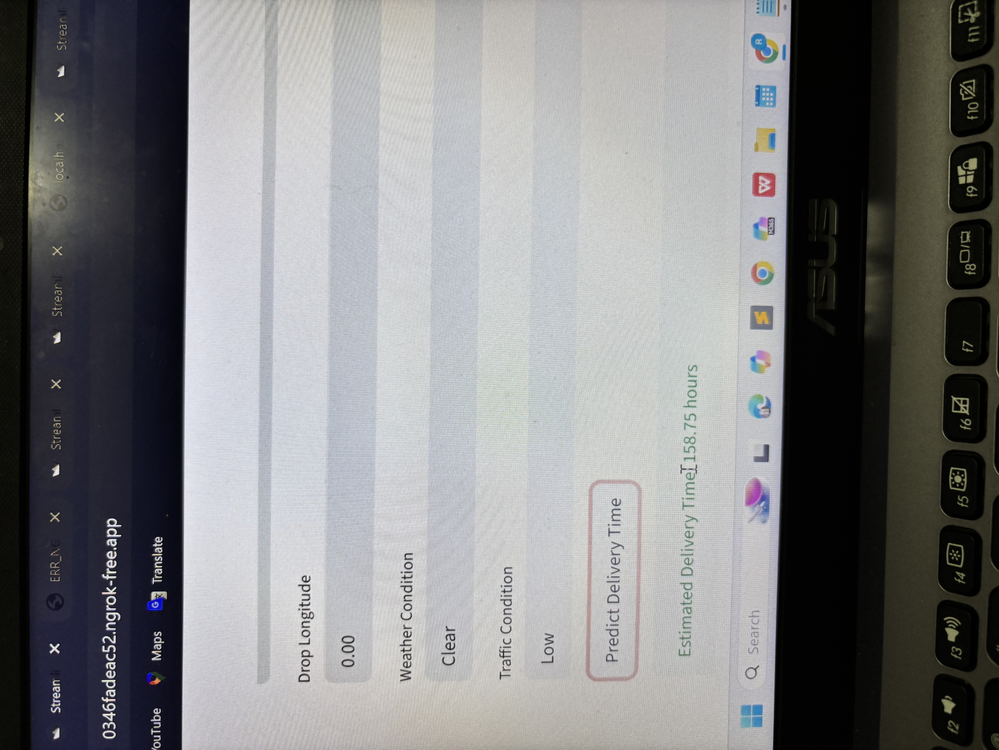

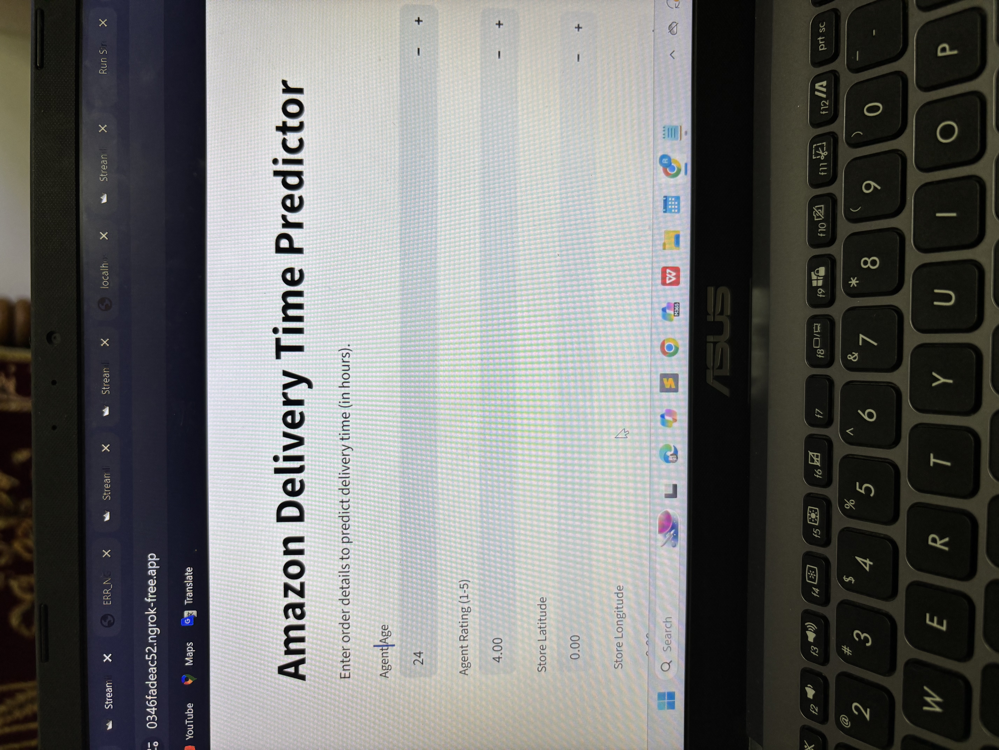

In [62]:
from IPython.display import Image, display

display(Image("/content/IMG_1247.jpeg"))
display(Image("/content/IMG_1248.jpeg"))


 Amazon Delivery Time Predictor

Objective:

Develop a predictive model to estimate Amazon delivery time based on agent, store, drop location, weather, and traffic data.

Deploy the model in an interactive web app for real-time predictions.

Data Processing & Model Training:

Collected and cleaned the delivery dataset.

Explored features including agent age, agent rating, store/drop latitude and longitude, weather, traffic, and other relevant factors.

Built and trained multiple machine learning models.

Evaluated models using metrics like R², RMSE, and MAE.

Selected the best-performing model (Random Forest Regressor) based on R² score.

Saved the final model as best_model.pkl.

App Development:

Created a Streamlit app for user-friendly interaction.

Users can enter key order details such as:

Agent Age & Rating

Store and Drop locations

Weather and Traffic conditions

App calculates approximate distance and formats input features for prediction.

Predicts delivery time in hours using the trained model.

Displays the estimated delivery time instantly.

Deployment:

App deployed via ngrok for public access.

Fully functional, tested with multiple input scenarios.

Users can access the app in any browser without installing additional software.

Outcome:

A working web application that predicts Amazon delivery time accurately.

Simplified user interface ensures quick and easy predictions.

Ready for demo, submission, or further enhancements.






*"The Streamlit app is hosted and accessed via a free ngrok tunnel for demonstration purposes."*
